# Sprint 公開されている実装を動かす
Faster R-CNN[1]の実装を動かします。<br>
<br>
[1]Ren, S., He, K., Girshick, R., Sun, J.: Faster r-cnn: Towards real-time object detection with region proposal networks. In: Advances in neural information processing systems. (2015) 91–99<br>

https://arxiv.org/pdf/1506.01497.pdf<br>
<br>
以下のものを使用してください。Kerasを使用した実装です。<br>
<br>
[duckrabbits/ObjectDetection at master](https://github.com/duckrabbits/ObjectDetection/tree/master)

## 環境構築

In [ ]:
!pip install tensorflow==1.5.0

In [ ]:
import tensorflow

/usr/local/lib/python3.6/dist-packages/tensorflow/python/framework/dtypes.py:493: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_qint8 = np.dtype([("qint8", np.int8, 1)])
/usr/local/lib/python3.6/dist-packages/tensorflow/python/framework/dtypes.py:494: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_quint8 = np.dtype([("quint8", np.uint8, 1)])
/usr/local/lib/python3.6/dist-packages/tensorflow/python/framework/dtypes.py:495: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_qint16 = np.dtype([("qint16", np.int16, 1)])
/usr/local/lib/python3.6/dist-packages/tensorflow/python/framework/dtypes.py:496: FutureWarning: Passing (type, 1) or 

In [ ]:
tensorflow.__version__

'1.5.0'

In [ ]:
!pip install kaggle

In [ ]:
# 自分のマイドライブにマウントする

from google.colab import drive
drive.mount('/content/drive/')

Go to this URL in a browser: https://accounts.google.com/o/oauth2/auth?client_id=947318989803-6bn6qk8qdgf4n4g3pfee6491hc0brc4i.apps.googleusercontent.com&redirect_uri=urn%3aietf%3awg%3aoauth%3a2.0%3aoob&response_type=code&scope=email%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdocs.test%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdrive%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdrive.photos.readonly%20https%3a%2f%2fwww.googleapis.com%2fauth%2fpeopleapi.readonly

Enter your authorization code:
··········
Mounted at /content/drive/


In [ ]:
mkdir .kaggle

In [ ]:
ls -a

./  ../  .config/  drive/  .kaggle/  sample_data/


In [ ]:
cd drive/"My Drive"

/content/drive/My Drive


In [ ]:
# https://www.kaggle.com/　へアクセスし、ログイン後に右上のプロフィール画像をクリック、さらに"My Account"をクリックする
# このサイトの「API」項目にある"Create New API Token"をクリックすると、kaggle.jsonファイルが自動的にダウンロードされる
# ローカルで、kaggle.json（ダウンロードフォルダにあるはず）をエディターで開く。
# このセルの以下のコードにある token = {'username':'***','key':'***'} における「***」部分を、
# ダウンロードしたkaggle.jsonを参照して書き換え、このセルを実行する

import json

token = {"username":"genkitamiya","key":"eec8e447673e3b2fbb70f50689415a1b"}
with open('/content/.kaggle/kaggle.json', 'w') as file:
    json.dump(token, file)

In [ ]:
!chmod 600 /content/.kaggle/kaggle.json

In [ ]:
pwd

'/content/drive/My Drive'

In [ ]:
ls -a .kaggle

ls: cannot access '.kaggle': No such file or directory


In [ ]:
mkdir　/root/.kaggle/

In [ ]:
!cp -R /content/.kaggle/kaggle.json /root/.kaggle/

In [ ]:
!ls -a /root/.kaggle/

.  ..  kaggle.json


In [ ]:
# kaggle APIコマンドが使えるかどうかを確認


!kaggle competitions list

ref                                               deadline             category            reward  teamCount  userHasEntered  
------------------------------------------------  -------------------  ---------------  ---------  ---------  --------------  
tpu-getting-started                               2030-06-03 23:59:00  Getting Started      Kudos         30           False  
digit-recognizer                                  2030-01-01 00:00:00  Getting Started  Knowledge       3355           False  
titanic                                           2030-01-01 00:00:00  Getting Started  Knowledge      25453            True  
house-prices-advanced-regression-techniques       2030-01-01 00:00:00  Getting Started  Knowledge       5719            True  
connectx                                          2030-01-01 00:00:00  Getting Started  Knowledge        552           False  
nlp-getting-started                               2030-01-01 00:00:00  Getting Started      Kudos       1802   

In [ ]:
# カレントディレクトリの変更

import os

os.chdir('/content/drive/My Drive/')

# カレントディレクトリの取得
print(os.getcwd())

/content/drive/My Drive


In [ ]:
# simpsonデータセットのAPIコマンドでデータセットをダウンロードする
# APIコマンドはこちらのサイトを参照。https://www.kaggle.com/alexattia/the-simpsons-characters-dataset

!kaggle datasets download -d alexattia/the-simpsons-characters-dataset --force

100% 1.07G/1.08G [00:11<00:00, 108MB/s] 
100% 1.08G/1.08G [00:11<00:00, 104MB/s]


In [ ]:
!unzip /content/drive/'My Drive'/the-simpsons-characters-dataset.zip  -d Simpsons

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Go to this URL in a browser: https://accounts.google.com/o/oauth2/auth?client_id=947318989803-6bn6qk8qdgf4n4g3pfee6491hc0brc4i.apps.googleusercontent.com&redirect_uri=urn%3aietf%3awg%3aoauth%3a2.0%3aoob&response_type=code&scope=email%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdocs.test%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdrive%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdrive.photos.readonly%20https%3a%2f%2fwww.googleapis.com%2fauth%2fpeopleapi.readonly

Enter your authorization code:
··········
Mounted at /content/drive


In [ ]:
!git clone https://github.com/duckrabbits/ObjectDetection.git

Cloning into 'ObjectDetection'...
remote: Enumerating objects: 18, done.
remote: Counting objects: 100% (18/18), done.
remote: Compressing objects: 100% (17/17), done.
remote: Total 46 (delta 3), reused 6 (delta 1), pack-reused 28
Unpacking objects: 100% (46/46), done.


In [ ]:
# https://github.com/duckrabbits/ObjectDetection/tree/master
# この後、上述のgithubのreadmeに沿って、simpsons_datasetフォルダをプロジェクトフォルダ配下に格納しましょう。
# testデータなども同様に準備してみよう。

In [ ]:
mv Simpsons/simpsons_dataset ObjectDetection/

In [ ]:
!mv Simpsons/kaggle_simpson_testset ObjectDetection/

## 【問題1】学習と推定
READMEを参考に上記実装を動かしてください。

In [ ]:
# Keras 2.3だとエラーが起こったため、2.2.0にダウングレード
!pip install keras==2.2.0

     |████████████████████████████████| 307kB 2.8MB/s 
     |████████████████████████████████| 51kB 4.8MB/s 
  Found existing installation: Keras-Preprocessing 1.1.2
    Uninstalling Keras-Preprocessing-1.1.2:
      Successfully uninstalled Keras-Preprocessing-1.1.2
  Found existing installation: Keras-Applications 1.0.8
    Uninstalling Keras-Applications-1.0.8:
      Successfully uninstalled Keras-Applications-1.0.8
  Found existing installation: Keras 2.3.1
    Uninstalling Keras-2.3.1:
      Successfully uninstalled Keras-2.3.1


In [ ]:
cd '/content/drive/My Drive/ObjectDetection'

/content/drive/My Drive/ObjectDetection


In [ ]:
!python train.py -p annotation.txt

Using TensorFlow backend.
/usr/local/lib/python3.6/dist-packages/tensorflow/python/framework/dtypes.py:493: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_qint8 = np.dtype([("qint8", np.int8, 1)])
/usr/local/lib/python3.6/dist-packages/tensorflow/python/framework/dtypes.py:494: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_quint8 = np.dtype([("quint8", np.uint8, 1)])
/usr/local/lib/python3.6/dist-packages/tensorflow/python/framework/dtypes.py:495: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_qint16 = np.dtype([("qint16", np.int16, 1)])
/usr/local/lib/python3.6/dist-packages/tensorflow/python/framework/dtypes.py:496: FutureWarn

In [ ]:
!python predict.py -i '/content/drive/My Drive/ObjectDetection/kaggle_simpson_testset/kaggle_simpson_testset' -c './save/train_20200622-031553_config.pickle'

## 【問題2】コードリーディング
上記実装のコードリーディングを行ってください。<br>
<br>
まず、Faster R-CNN[1]において重要だと考えた部分を列挙してください。そして、それに対応するコードを見つけてください。<br>
<br>
**（例）**
- RPNを実現しているコードはどこか
- RoIプーリングを実現しているコードはどこか<br>

フレームワークには畳み込み層など一般的なものはクラスが用意されていますが、RoIプーリングなど特定の手法限定のものは用意されていません。オリジナルのレイヤーを作成することが可能であり、Kerasであれば以下のページに情報がまとまっています。<br>

[オリジナルのKerasレイヤーを作成する - Keras Documentation](https://keras.io/ja/layers/writing-your-own-keras-layers/)<br>
<br>
**《参考》**<br>
<br>
KerasではVGG16のクラスが用意されているため、簡単に利用ができます。include_top=Falseの引数を与えることで、出力のための全結合層部分が除かれます。weights='imagenet'でImageNetを利用した学習済みモデルも手に入り、転移学習 が行えます。weights='None'とすればランダムな初期化となります。<br>
<br>
[Applications - Keras Documentation](https://keras.io/ja/applications/#vgg16)

- RPN<br>
    - model.resnet.rpnにコードあり
```
def rpn(base_layers,num_anchors):

    x = Convolution2D(512, (3, 3), padding='same', activation='relu', kernel_initializer='normal', name='rpn_conv1')(base_layers)

    x_class = Convolution2D(num_anchors, (1, 1), activation='sigmoid', kernel_initializer='uniform', name='rpn_out_class')(x)
    x_regr = Convolution2D(num_anchors * 4, (1, 1), activation='linear', kernel_initializer='zero', name='rpn_out_regress')(x)

    return [x_class, x_regr, base_layers]
```
- RoI Pooling
    - model.RoiPoolingConv.RoiPoolingConvにコードあり
- Classifier
    - model.resnet.classifierにコードあり
```
def classifier(base_layers, input_rois, num_rois, nb_classes = 21, trainable=False):

    pooling_regions = 14
    input_shape = (num_rois,14,14,1024)
    out_roi_pool = RoiPoolingConv(pooling_regions, num_rois)([base_layers, input_rois])
    out = classifier_layers(out_roi_pool, input_shape=input_shape, trainable=True)

    out = TimeDistributed(Flatten())(out)

    out_class = TimeDistributed(Dense(nb_classes, activation='softmax', kernel_initializer='zero'), name='dense_class_{}'.format(nb_classes))(out)
    # note: no regression target for bg class
    out_regr = TimeDistributed(Dense(4 * (nb_classes-1), activation='linear', kernel_initializer='zero'), name='dense_regress_{}'.format(nb_classes))(out)
    return [out_class, out_regr]
```
- Anchor Box parameters
    - config.configクラス内

## YOLOv3
シンプソンズのデータセットをFaster R-CNN以外の手法で学習・推定を行います。YOLOv3[2]のKeras実装を使います。<br>
<br>
[qqwweee/keras-yolo3: A Keras implementation of YOLOv3 (Tensorflow backend)](https://github.com/qqwweee/keras-yolo3)<br>
<br>
[2]Jeseph Redmon, Ali Farhadi. YOLOv3: An Incremental Improvement<br>
<br>
https://pjreddie.com/media/files/papers/YOLOv3.pdf

## 【問題3】学習済みの重みによる推定
学習済みの重みを使い推定を行う方法がREADME.mdのQuick Startの項に記載されています。<br>
<br>
まずはこの通りにして各自何かしらの画像や動画に対して検出を行ってください。<br>
<br>
出力結果を課題の一部として提出してください。

In [ ]:
!git clone https://github.com/qqwweee/keras-yolo3.git

Cloning into 'keras-yolo3'...
remote: Enumerating objects: 144, done.
remote: Total 144 (delta 0), reused 0 (delta 0), pack-reused 144
Receiving objects: 100% (144/144), 151.07 KiB | 418.00 KiB/s, done.
Resolving deltas: 100% (65/65), done.


In [ ]:
!wget https://pjreddie.com/media/files/yolov3.weights

--2020-06-22 06:31:01--  https://pjreddie.com/media/files/yolov3.weights
Resolving pjreddie.com (pjreddie.com)... 128.208.4.108
Connecting to pjreddie.com (pjreddie.com)|128.208.4.108|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 248007048 (237M) [application/octet-stream]
Saving to: ‘yolov3.weights’

yolov3.weights      100%[===================>] 236.52M   128KB/s    in 14m 11s 

2020-06-22 06:45:14 (285 KB/s) - ‘yolov3.weights’ saved [248007048/248007048]



In [ ]:
pwd

'/content/drive/My Drive'

In [ ]:
cd /content/drive/'My Drive'/keras-yolo3

/content/drive/My Drive/keras-yolo3


In [ ]:
pwd

'/content/drive/My Drive/keras-yolo3'

In [ ]:
!python convert.py yolov3.cfg yolov3.weights model_data/yolo.h5

Using TensorFlow backend.
/usr/local/lib/python3.6/dist-packages/tensorflow/python/framework/dtypes.py:493: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_qint8 = np.dtype([("qint8", np.int8, 1)])
/usr/local/lib/python3.6/dist-packages/tensorflow/python/framework/dtypes.py:494: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_quint8 = np.dtype([("quint8", np.uint8, 1)])
/usr/local/lib/python3.6/dist-packages/tensorflow/python/framework/dtypes.py:495: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_qint16 = np.dtype([("qint16", np.int16, 1)])
/usr/local/lib/python3.6/dist-packages/tensorflow/python/framework/dtypes.py:496: FutureWarn

>colab上だとPILのimage.showが使えないため、出力画像を保存するためのコードを追記。

```
import os, ntpath

def detect_img(yolo):
    output_dir = '/content/drive/My Drive/keras-yolo3/output/'
    if not(os.path.isdir(output_dir)):
        os.makedirs(output_dir)
    
    while True:
        img = input('Input image filename:')
        try:
            image = Image.open(img)
        except:
            print('Open Error! Try again!')
            continue
        else:
            _, file_name = ntpath.split(img)
            r_image = yolo.detect_image(image)
            r_image.show()
            r_image.save(output_dir + 'result_{}.png'.format(file_name.replace('.jpg', '')))
    yolo.close_session()
```

### 動物画像の検出

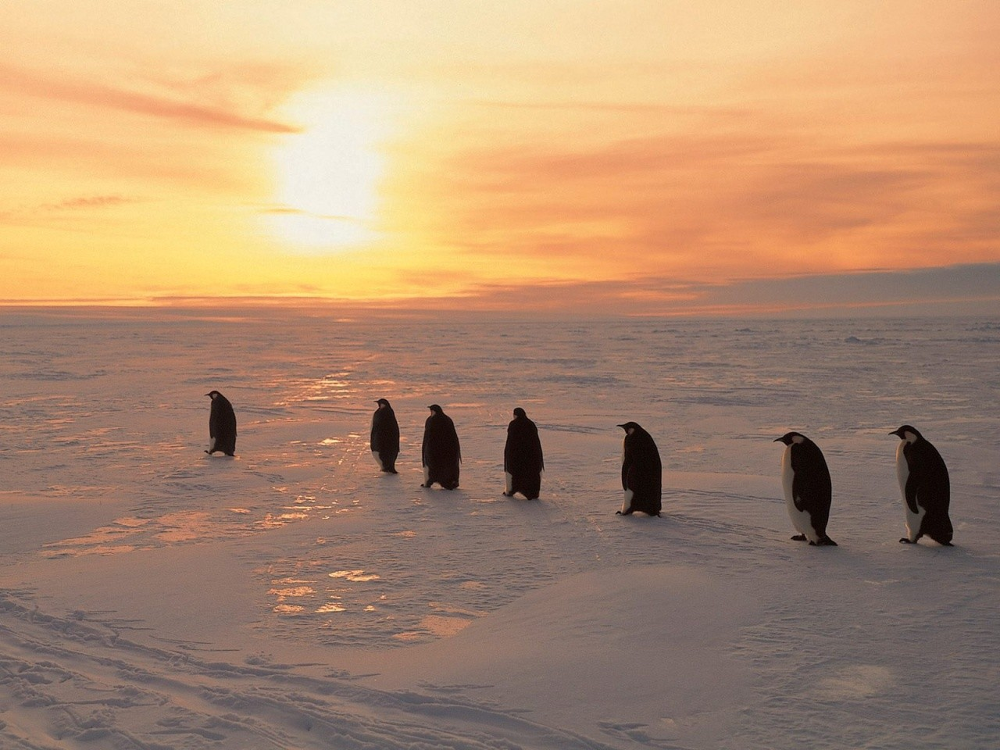

In [ ]:
# 推定前の画像を確認
from IPython.display import Image
Image(filename='/content/drive/My Drive/4ed597c5.jpg') 

In [ ]:
!python yolo_video.py --image

Using TensorFlow backend.
/usr/local/lib/python3.6/dist-packages/tensorflow/python/framework/dtypes.py:493: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_qint8 = np.dtype([("qint8", np.int8, 1)])
/usr/local/lib/python3.6/dist-packages/tensorflow/python/framework/dtypes.py:494: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_quint8 = np.dtype([("quint8", np.uint8, 1)])
/usr/local/lib/python3.6/dist-packages/tensorflow/python/framework/dtypes.py:495: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_qint16 = np.dtype([("qint16", np.int16, 1)])
/usr/local/lib/python3.6/dist-packages/tensorflow/python/framework/dtypes.py:496: FutureWarn

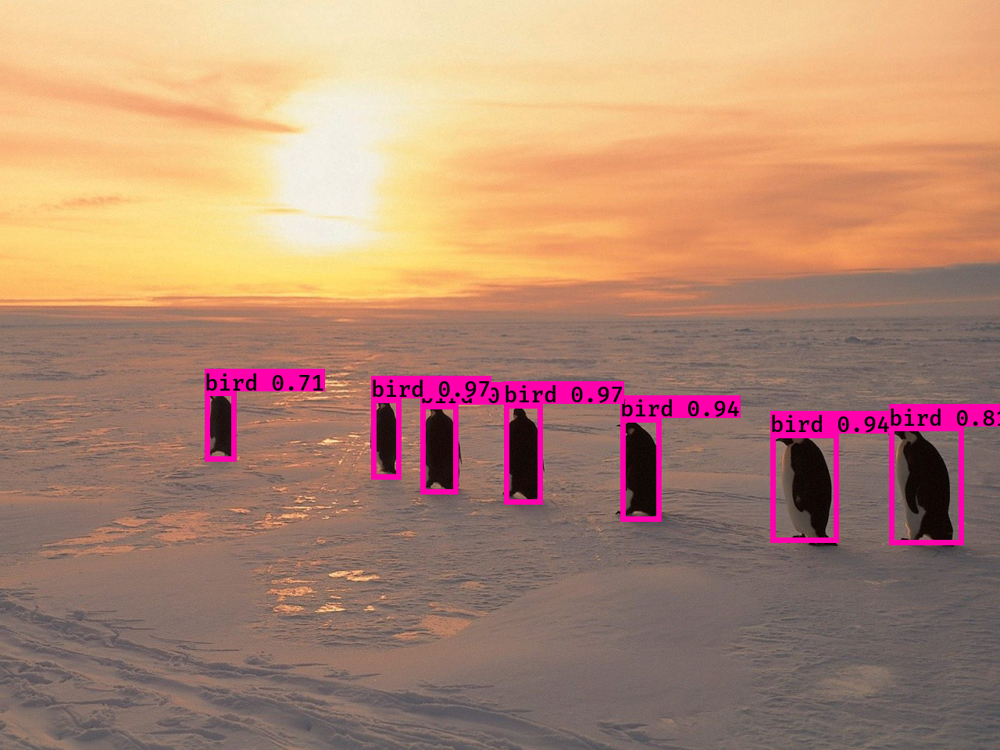

In [ ]:
# 推定後の画像を確認
Image(filename='/content/drive/My Drive/keras-yolo3/output/result_4ed597c5.png') 

>ペンギンが全て無事検出された。

### 風景画像の検出

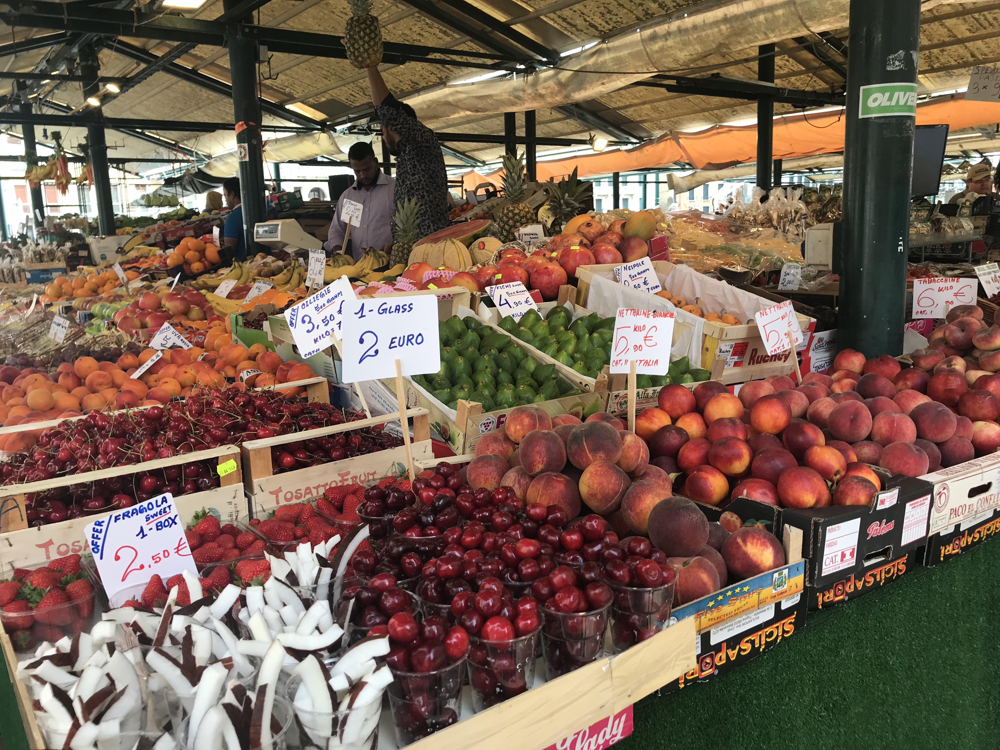

In [ ]:
# 推定前の画像を確認
Image(filename='/content/drive/My Drive/IMG_7319.png') 

In [ ]:
!python yolo_video.py --image

Using TensorFlow backend.
/usr/local/lib/python3.6/dist-packages/tensorflow/python/framework/dtypes.py:493: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_qint8 = np.dtype([("qint8", np.int8, 1)])
/usr/local/lib/python3.6/dist-packages/tensorflow/python/framework/dtypes.py:494: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_quint8 = np.dtype([("quint8", np.uint8, 1)])
/usr/local/lib/python3.6/dist-packages/tensorflow/python/framework/dtypes.py:495: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_qint16 = np.dtype([("qint16", np.int16, 1)])
/usr/local/lib/python3.6/dist-packages/tensorflow/python/framework/dtypes.py:496: FutureWarn

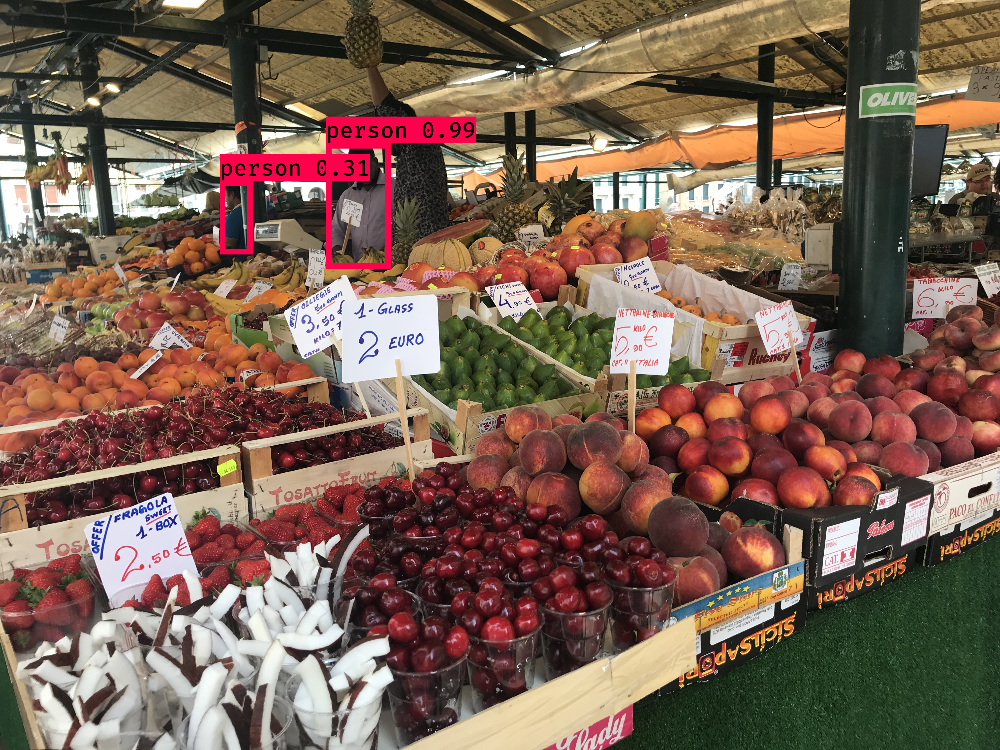

In [ ]:
# 推定後の画像を確認
Image(filename='/content/drive/My Drive/keras-yolo3/output/result_IMG_7319.png') 

>人のみ検出され、果物は検出されなかった。果物がお互いに近すぎたため検出されなかったのだろうか。

### 動画からの検出

colab上ではcv2.VideoCaptureによる動画読み込みが失敗したため（引数入力からのファイルパス取得に失敗？）、下記コードに変換。<br>
参照：[github](https://github.com/qqwweee/keras-yolo3/issues/149)

```
def detect_video(yolo, video_path, output_path=""):
    import cv2
    # vid = cv2.VideoCapture(video_path)
    pfad="/content/drive/My Drive/Office-Parkour.mp4"
    vid = cv2.VideoCapture(pfad)
```

また、'cannot connect to X server'を解消するため、下記コードをコメントアウトした。<br>
参照：[github](https://github.com/qqwweee/keras-yolo3/issues/522)

```
# cv2.namedWindow("result", cv2.WINDOW_NORMAL)
# cv2.imshow("result", result)
```

一度実行したところ、最終フレームの処理中にエラーが出たため、解決策を調査。調べたところ、最終フレームだけframe変数がNonetypeとなるため、下記break処理を追記。<br>
参照：[qiita](https://qiita.com/toten_s/items/04d0744598e8c3d9bc9b)
```
while True:
    return_value, frame = vid.read()
    if type(frame) == type(None): break
    image = Image.fromarray(frame)
```

しかし、出力動画の保存は出来ておらず、エラーを確認したら下記を確認。
```
CAP_IMAGES: can't find starting number (in the name of file): [/content/drive/My Drive/result_Office-parkour.avi] in function 'icvExtractPattern'
```

今回はここで調査を止め、後日改めて原因を突き止めたいと思う。


In [10]:
!python yolo_video.py --input [/content/drive/'My Drive'/Office-Parkour.mp4] --output [/content/drive/'My Drive'/result_Office-parkour.avi]

Using TensorFlow backend.
/usr/local/lib/python3.6/dist-packages/tensorflow/python/framework/dtypes.py:493: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_qint8 = np.dtype([("qint8", np.int8, 1)])
/usr/local/lib/python3.6/dist-packages/tensorflow/python/framework/dtypes.py:494: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_quint8 = np.dtype([("quint8", np.uint8, 1)])
/usr/local/lib/python3.6/dist-packages/tensorflow/python/framework/dtypes.py:495: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_qint16 = np.dtype([("qint16", np.int16, 1)])
/usr/local/lib/python3.6/dist-packages/tensorflow/python/framework/dtypes.py:496: FutureWarn

## 【問題4】学習のためのファイルを作成
新しいデータ（シンプソンズデータセット）を学習します。README.mdのTrainingの項を読み、シンプソンズデータセットを学習するために必要なファイルを作成してください。<br>
<br>
アノテーションファイルの形式が問題1の実装とは異なるため変換する必要があります。

In [ ]:
# Faster R-CNNで使用したファイルをndarrayとして読み込む
import numpy as np
anot = np.loadtxt('/content/drive/My Drive/ObjectDetection/annotation.txt', dtype=str, delimiter=',')
print(anot)

[['simpsons_dataset/abraham_grampa_simpson/pic_0000.jpg' '57' '72' '52'
  '72' 'abraham_grampa_simpson']
 ['simpsons_dataset/abraham_grampa_simpson/pic_0001.jpg' '80' '31' '337'
  '354' 'abraham_grampa_simpson']
 ['simpsons_dataset/abraham_grampa_simpson/pic_0002.jpg' '128' '48' '285'
  '407' 'abraham_grampa_simpson']
 ...
 ['simpsons_dataset/moe_szyslak/pic_0337.jpg' '66' '75' '196' '245'
  'moe_szyslak']
 ['simpsons_dataset/moe_szyslak/pic_1067.jpg' '159' '44' '287' '247'
  'moe_szyslak']
 ['simpsons_dataset/moe_szyslak/pic_0928.jpg' '185' '64' '396' '329'
  'moe_szyslak']]


In [ ]:
# カテゴリ変数を数値に変換
from sklearn.preprocessing import LabelEncoder

enc = LabelEncoder()
anot[:,5] = enc.fit_transform(anot[:,5])
print(anot)

[['simpsons_dataset/abraham_grampa_simpson/pic_0000.jpg' '57' '72' '52'
  '72' '0']
 ['simpsons_dataset/abraham_grampa_simpson/pic_0001.jpg' '80' '31' '337'
  '354' '0']
 ['simpsons_dataset/abraham_grampa_simpson/pic_0002.jpg' '128' '48' '285'
  '407' '0']
 ...
 ['simpsons_dataset/moe_szyslak/pic_0337.jpg' '66' '75' '196' '245' '5']
 ['simpsons_dataset/moe_szyslak/pic_1067.jpg' '159' '44' '287' '247' '5']
 ['simpsons_dataset/moe_szyslak/pic_0928.jpg' '185' '64' '396' '329' '5']]


In [ ]:
# yoloはannotationが2列のため（Fasterは6列）
# yolo形式に編集し、txtとして保存

anot_yolo = []
for i in range(len(anot)):
  
  anot_yolo.append([anot[i,0], ','.join(anot[i, 1:])])

anot_yolo = np.array(anot_yolo)
np.savetxt('/content/drive/My Drive/keras-yolo3/train.txt', anot_yolo, fmt='%s %s')

##【問題5】学習が行えることの確認
問題4で作成したファイルを使用して学習してください。実行環境で学習に時間がかかる場合は、学習が行えることを確認するのみで終えて構いません。

In [ ]:
!python convert.py -w yolov3.cfg yolov3.weights model_data/yolo_weights.h5

Using TensorFlow backend.
2020-06-22 13:52:48.127944: I tensorflow/stream_executor/platform/default/dso_loader.cc:44] Successfully opened dynamic library libcudart.so.10.1
Loading weights.
Weights Header:  0 2 0 [32013312]
Parsing Darknet config.
Creating Keras model.
Parsing section net_0
Parsing section convolutional_0
conv2d bn leaky (3, 3, 3, 32)
2020-06-22 13:52:50.528271: I tensorflow/stream_executor/platform/default/dso_loader.cc:44] Successfully opened dynamic library libcuda.so.1
2020-06-22 13:52:50.546478: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:981] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2020-06-22 13:52:50.547259: I tensorflow/core/common_runtime/gpu/gpu_device.cc:1561] Found device 0 with properties: 
pciBusID: 0000:00:04.0 name: Tesla K80 computeCapability: 3.7
coreClock: 0.8235GHz coreCount: 13 deviceMemorySize: 11.17GiB deviceMemoryBandwidth: 223.96GiB/s
2020-06-2

In [ ]:
!python /content/drive/'My Drive'/keras-yolo3/train.py

Using TensorFlow backend.
/usr/local/lib/python3.6/dist-packages/tensorflow/python/framework/dtypes.py:493: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_qint8 = np.dtype([("qint8", np.int8, 1)])
/usr/local/lib/python3.6/dist-packages/tensorflow/python/framework/dtypes.py:494: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_quint8 = np.dtype([("quint8", np.uint8, 1)])
/usr/local/lib/python3.6/dist-packages/tensorflow/python/framework/dtypes.py:495: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_qint16 = np.dtype([("qint16", np.int16, 1)])
/usr/local/lib/python3.6/dist-packages/tensorflow/python/framework/dtypes.py:496: FutureWarn

>学習が無事始まったが、長いため途中で停止。

## 【問題6】（アドバンス課題）コードリーディング
上記実装のコードリーディングを行ってください。<br>
<br>
まず、YOLOv3[2]の論文において重要だと考えた部分を列挙してください。そして、それに対応するコードを見つけてください。

>yolo3の重要と思われる関数やコードとそれらの役割を下記にまとめる。
- yolo3.model.yolo_body
    - yoloのCNNネットワークを構築
- yolo3.model.make_last_layers
    - 各スケールに応じたdetector部分のレイヤー
- yolo3.model.yolo_head
    - yolo_bodyネットワークの出力特徴量をbounding box + class predictionsに変換。出力はgridのshapeとなる。
- yolo3.model.yolo_boxes_and_scores
    - yolo_headの推定をとground truth bounding boxの誤差を基に、モデルのスコアを算出
- yolo3.model.yolo_eval
    - 入力データ毎にyolo_boxes_and_scoresをまとめる
- yolo.YOLO.generate
    - YOLOクラスを生成した際に呼び、yolo_evalを実行させる
- yolo.YOLO.detect_image & detect_video
    - 入力データの形状（画像・動画）によって出力を変換（動画はフレーム毎にbounding boxを出力し、全ての出力画像を再度動画に編集）
- yolo_video
    - 推定を実行させるスクリプト
>
><br>
>YOLOはFaster R-CNNと違い、bounding boxとクラス推定を同時に行うことが特徴。下記に該当すると思われるコードを記載
>
>- Bounding Box Predictor & Class Prediction
    - CNNネットワーク（Darknet）が推定した特徴量をyolo_head関数でbounding boxパラメータとクラス推定に変換し、yolo_boxes_and_scoresが正解ラベル（yolo_correct_boxes）と比較したスコアを出力
    - yolo_evalが上記出力結果を入力データ毎にリスト化する

```
# keras-yolo3/yolo3/model.pyより抜粋

def yolo_head(feats, anchors, num_classes, input_shape, calc_loss=False):
    """Convert final layer features to bounding box parameters."""
    num_anchors = len(anchors)
    # Reshape to batch, height, width, num_anchors, box_params.
    anchors_tensor = K.reshape(K.constant(anchors), [1, 1, 1, num_anchors, 2])

    grid_shape = K.shape(feats)[1:3] # height, width
    grid_y = K.tile(K.reshape(K.arange(0, stop=grid_shape[0]), [-1, 1, 1, 1]),
        [1, grid_shape[1], 1, 1])
    grid_x = K.tile(K.reshape(K.arange(0, stop=grid_shape[1]), [1, -1, 1, 1]),
        [grid_shape[0], 1, 1, 1])
    grid = K.concatenate([grid_x, grid_y])
    grid = K.cast(grid, K.dtype(feats))

    feats = K.reshape(
        feats, [-1, grid_shape[0], grid_shape[1], num_anchors, num_classes + 5])

    # Adjust preditions to each spatial grid point and anchor size.
    box_xy = (K.sigmoid(feats[..., :2]) + grid) / K.cast(grid_shape[::-1], K.dtype(feats))
    box_wh = K.exp(feats[..., 2:4]) * anchors_tensor / K.cast(input_shape[::-1], K.dtype(feats))
    box_confidence = K.sigmoid(feats[..., 4:5])
    box_class_probs = K.sigmoid(feats[..., 5:])

    if calc_loss == True:
        return grid, feats, box_xy, box_wh
    return box_xy, box_wh, box_confidence, box_class_probs

def yolo_boxes_and_scores(feats, anchors, num_classes, input_shape, image_shape):
    '''Process Conv layer output'''
    box_xy, box_wh, box_confidence, box_class_probs = yolo_head(feats,
        anchors, num_classes, input_shape)
    boxes = yolo_correct_boxes(box_xy, box_wh, input_shape, image_shape)
    boxes = K.reshape(boxes, [-1, 4])
    box_scores = box_confidence * box_class_probs
    box_scores = K.reshape(box_scores, [-1, num_classes])
    return boxes, box_scores

def yolo_eval(yolo_outputs,
              anchors,
              num_classes,
              image_shape,
              max_boxes=20,
              score_threshold=.6,
              iou_threshold=.5):
    """Evaluate YOLO model on given input and return filtered boxes."""
    num_layers = len(yolo_outputs)
    anchor_mask = [[6,7,8], [3,4,5], [0,1,2]] if num_layers==3 else [[3,4,5], [1,2,3]] # default setting
    input_shape = K.shape(yolo_outputs[0])[1:3] * 32
    boxes = []
    box_scores = []
    for l in range(num_layers):
        _boxes, _box_scores = yolo_boxes_and_scores(yolo_outputs[l],
            anchors[anchor_mask[l]], num_classes, input_shape, image_shape)
        boxes.append(_boxes)
        box_scores.append(_box_scores)
    boxes = K.concatenate(boxes, axis=0)
    box_scores = K.concatenate(box_scores, axis=0)

    mask = box_scores >= score_threshold
    max_boxes_tensor = K.constant(max_boxes, dtype='int32')
    boxes_ = []
    scores_ = []
    classes_ = []
    for c in range(num_classes):
        # TODO: use keras backend instead of tf.
        class_boxes = tf.boolean_mask(boxes, mask[:, c])
        class_box_scores = tf.boolean_mask(box_scores[:, c], mask[:, c])
        nms_index = tf.image.non_max_suppression(
            class_boxes, class_box_scores, max_boxes_tensor, iou_threshold=iou_threshold)
        class_boxes = K.gather(class_boxes, nms_index)
        class_box_scores = K.gather(class_box_scores, nms_index)
        classes = K.ones_like(class_box_scores, 'int32') * c
        boxes_.append(class_boxes)
        scores_.append(class_box_scores)
        classes_.append(classes)
    boxes_ = K.concatenate(boxes_, axis=0)
    scores_ = K.concatenate(scores_, axis=0)
    classes_ = K.concatenate(classes_, axis=0)

    return boxes_, scores_, classes_
```
